# **<u>Customer Transaction Prediction</u>**
### **-Sidharth A**

# Problem statement

To create a predictive model which will help the bank to identify which
customer will make transactions in future.

## Importing Libraries

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

## Loading dataset

In [2]:
data = pd.read_csv('train(1)-Copy1.csv')
data

,ID_code,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
0,train_0,0,8.9255,-6.7863,11.9081,5.0930,11.4607,-9.2834,5.1187,18.6266,...,4.4354,3.9642,3.1364,1.6910,18.5227,-2.3978,7.8784,8.5635,12.7803,-1.0914
1,train_1,0,11.5006,-4.1473,13.8588,5.3890,12.3622,7.0433,5.6208,16.5338,...,7.6421,7.7214,2.5837,10.9516,15.4305,2.0339,8.1267,8.7889,18.3560,1.9518
2,train_2,0,8.6093,-2.7457,12.0805,7.8928,10.5825,-9.0837,6.9427,14.6155,...,2.9057,9.7905,1.6704,1.6858,21.6042,3.1417,-6.5213,8.2675,14.7222,0.3965
3,train_3,0,11.0604,-2.1518,8.9522,7.1957,12.5846,-1.8361,5.8428,14.9250,...,4.4666,4.7433,0.7178,1.4214,23.0347,-1.2706,-2.9275,10.2922,17.9697,-8.9996
4,train_4,0,9.8369,-1.4834,12.8746,6.6375,12.2772,2.4486,5.9405,19.2514,...,-1.4905,9.5214,-0.1508,9.1942,13.2876,-1.5121,3.9267,9.5031,17.9974,-8.8104
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199995,train_199995,0,11.4880,-0.4956,8.2622,3.5142,10.3404,11.6081,5.6709,15.1516,...,6.1415,13.2305,3.9901,0.9388,18.0249,-1.7939,2.1661,8.5326,16.6660,-17.8661
199996,train_199996,0,4.9149,-2.4484,16.7052,6.6345,8.3096,-10.5628,5.8802,21.5940,...,4.9611,4.6549,0.6998,1.8341,22.2717,1.7337,-2.1651,6.7419,15.9054,0.3388
199997,train_199997,0,11.2232,-5.0518,10.5127,5.6456,9.3410,-5.4086,4.5555,21.5571,...,4.0651,5.4414,3.1032,4.8793,23.5311,-1.5736,1.2832,8.7155,13.8329,4.1995
199998,train_199998,0,9.7148,-8.6098,13.6104,5.7930,12.5173,0.5339,6.0479,17.0152,...,2.6840,8.6587,2.7337,11.1178,20.4158,-0.0786,6.7980,10.0342,15.5289,-13.9001


# Data information

The dataset is anonymized so we cannot know which feature is what.
There are a total of 200 features in this data set along with ID_code
and target columns. The target columns contain 0 and 1 value where 0
means the customer will not do a transaction and 1 means the
customer will do a transaction.

## Basic checks

In [3]:
#columns
data.columns

Index(['ID_code', 'target', 'var_0', 'var_1', 'var_2', 'var_3', 'var_4',
       'var_5', 'var_6', 'var_7',
       ...
       'var_190', 'var_191', 'var_192', 'var_193', 'var_194', 'var_195',
       'var_196', 'var_197', 'var_198', 'var_199'],
      dtype='object', length=202)

In [4]:
#shape of the data
print('No. of rows :',data.shape[0])
print('No. of columns :',data.shape[1])

No. of rows : 200000
No. of columnss : 202


In [5]:
#datatypes
data.dtypes

ID_code     object
target       int64
var_0      float64
var_1      float64
var_2      float64
            ...   
var_195    float64
var_196    float64
var_197    float64
var_198    float64
var_199    float64
Length: 202, dtype: object

#### Insights
* The only categorical feature is ID_code which have unique values.
* The datatype of target column is int and rest of all independent features are float.

In [6]:
#info
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Columns: 202 entries, ID_code to var_199
dtypes: float64(200), int64(1), object(1)
memory usage: 308.2+ MB


In [7]:
#missing values
mv = data.isnull().sum()
mv

ID_code    0
target     0
var_0      0
var_1      0
var_2      0
          ..
var_195    0
var_196    0
var_197    0
var_198    0
var_199    0
Length: 202, dtype: int64

In [8]:
np.unique(mv)

array([0], dtype=int64)

#### Insights
* There is no missing values in the dataset.

In [9]:
data.describe()

,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
count,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,...,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000
mean,0.100490,10.679914,-1.627622,10.715192,6.796529,11.078333,-5.065317,5.408949,16.545850,0.284162,...,3.234440,7.438408,1.927839,3.331774,17.993784,-0.142088,2.303335,8.908158,15.870720,-3.326537
std,0.300653,3.040051,4.050044,2.640894,2.043319,1.623150,7.863267,0.866607,3.418076,3.332634,...,4.559922,3.023272,1.478423,3.992030,3.135162,1.429372,5.454369,0.921625,3.010945,10.438015
min,0.000000,0.408400,-15.043400,2.117100,-0.040200,5.074800,-32.562600,2.347300,5.349700,-10.505500,...,-14.093300,-2.691700,-3.814500,-11.783400,8.694400,-5.261000,-14.209600,5.960600,6.299300,-38.852800
25%,0.000000,8.453850,-4.740025,8.722475,5.254075,9.883175,-11.200350,4.767700,13.943800,-2.317800,...,-0.058825,5.157400,0.889775,0.584600,15.629800,-1.170700,-1.946925,8.252800,13.829700,-11.208475
50%,0.000000,10.524750,-1.608050,10.580000,6.825000,11.108250,-4.833150,5.385100,16.456800,0.393700,...,3.203600,7.347750,1.901300,3.396350,17.957950,-0.172700,2.408900,8.888200,15.934050,-2.819550
75%,0.000000,12.758200,1.358625,12.516700,8.324100,12.261125,0.924800,6.003000,19.102900,2.937900,...,6.406200,9.512525,2.949500,6.205800,20.396525,0.829600,6.556725,9.593300,18.064725,4.836800
max,1.000000,20.315000,10.376800,19.353000,13.188300,16.671400,17.251600,8.447700,27.691800,10.151300,...,18.440900,16.716500,8.402400,18.281800,27.928800,4.272900,18.321500,12.000400,26.079100,28.500700


In [10]:
#checking for duplicated records
data.duplicated().sum()

0

In [11]:
#value counts in target variable
data.target.value_counts()

0    179902
1     20098
Name: target, dtype: int64

# Data Preprocessing

In [12]:
data

,ID_code,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
0,train_0,0,8.9255,-6.7863,11.9081,5.0930,11.4607,-9.2834,5.1187,18.6266,...,4.4354,3.9642,3.1364,1.6910,18.5227,-2.3978,7.8784,8.5635,12.7803,-1.0914
1,train_1,0,11.5006,-4.1473,13.8588,5.3890,12.3622,7.0433,5.6208,16.5338,...,7.6421,7.7214,2.5837,10.9516,15.4305,2.0339,8.1267,8.7889,18.3560,1.9518
2,train_2,0,8.6093,-2.7457,12.0805,7.8928,10.5825,-9.0837,6.9427,14.6155,...,2.9057,9.7905,1.6704,1.6858,21.6042,3.1417,-6.5213,8.2675,14.7222,0.3965
3,train_3,0,11.0604,-2.1518,8.9522,7.1957,12.5846,-1.8361,5.8428,14.9250,...,4.4666,4.7433,0.7178,1.4214,23.0347,-1.2706,-2.9275,10.2922,17.9697,-8.9996
4,train_4,0,9.8369,-1.4834,12.8746,6.6375,12.2772,2.4486,5.9405,19.2514,...,-1.4905,9.5214,-0.1508,9.1942,13.2876,-1.5121,3.9267,9.5031,17.9974,-8.8104
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199995,train_199995,0,11.4880,-0.4956,8.2622,3.5142,10.3404,11.6081,5.6709,15.1516,...,6.1415,13.2305,3.9901,0.9388,18.0249,-1.7939,2.1661,8.5326,16.6660,-17.8661
199996,train_199996,0,4.9149,-2.4484,16.7052,6.6345,8.3096,-10.5628,5.8802,21.5940,...,4.9611,4.6549,0.6998,1.8341,22.2717,1.7337,-2.1651,6.7419,15.9054,0.3388
199997,train_199997,0,11.2232,-5.0518,10.5127,5.6456,9.3410,-5.4086,4.5555,21.5571,...,4.0651,5.4414,3.1032,4.8793,23.5311,-1.5736,1.2832,8.7155,13.8329,4.1995
199998,train_199998,0,9.7148,-8.6098,13.6104,5.7930,12.5173,0.5339,6.0479,17.0152,...,2.6840,8.6587,2.7337,11.1178,20.4158,-0.0786,6.7980,10.0342,15.5289,-13.9001


In [13]:
#checking uniqueness
data.ID_code.is_unique

True

In [14]:
#dropping ID_code
data.drop('ID_code',axis=1,inplace=True)
data

,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
0,0,8.9255,-6.7863,11.9081,5.0930,11.4607,-9.2834,5.1187,18.6266,-4.9200,...,4.4354,3.9642,3.1364,1.6910,18.5227,-2.3978,7.8784,8.5635,12.7803,-1.0914
1,0,11.5006,-4.1473,13.8588,5.3890,12.3622,7.0433,5.6208,16.5338,3.1468,...,7.6421,7.7214,2.5837,10.9516,15.4305,2.0339,8.1267,8.7889,18.3560,1.9518
2,0,8.6093,-2.7457,12.0805,7.8928,10.5825,-9.0837,6.9427,14.6155,-4.9193,...,2.9057,9.7905,1.6704,1.6858,21.6042,3.1417,-6.5213,8.2675,14.7222,0.3965
3,0,11.0604,-2.1518,8.9522,7.1957,12.5846,-1.8361,5.8428,14.9250,-5.8609,...,4.4666,4.7433,0.7178,1.4214,23.0347,-1.2706,-2.9275,10.2922,17.9697,-8.9996
4,0,9.8369,-1.4834,12.8746,6.6375,12.2772,2.4486,5.9405,19.2514,6.2654,...,-1.4905,9.5214,-0.1508,9.1942,13.2876,-1.5121,3.9267,9.5031,17.9974,-8.8104
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199995,0,11.4880,-0.4956,8.2622,3.5142,10.3404,11.6081,5.6709,15.1516,-0.6209,...,6.1415,13.2305,3.9901,0.9388,18.0249,-1.7939,2.1661,8.5326,16.6660,-17.8661
199996,0,4.9149,-2.4484,16.7052,6.6345,8.3096,-10.5628,5.8802,21.5940,-3.6797,...,4.9611,4.6549,0.6998,1.8341,22.2717,1.7337,-2.1651,6.7419,15.9054,0.3388
199997,0,11.2232,-5.0518,10.5127,5.6456,9.3410,-5.4086,4.5555,21.5571,0.1202,...,4.0651,5.4414,3.1032,4.8793,23.5311,-1.5736,1.2832,8.7155,13.8329,4.1995
199998,0,9.7148,-8.6098,13.6104,5.7930,12.5173,0.5339,6.0479,17.0152,-2.1926,...,2.6840,8.6587,2.7337,11.1178,20.4158,-0.0786,6.7980,10.0342,15.5289,-13.9001


In [15]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Columns: 201 entries, target to var_199
dtypes: float64(200), int64(1)
memory usage: 306.7 MB


In [16]:
#Reducing the size of the data to make computationns and operations easy
data = data.apply(pd.to_numeric,downcast='float')

In [17]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Columns: 201 entries, target to var_199
dtypes: float32(201)
memory usage: 153.4 MB


#### Insights
* Initially the data was 306MB. But after downcasting for reducing computation time, it became 153MB which is half of the size of initial data. 

### Distribution check

In [18]:
plt.figure(figsize=(200,200))
plotnumber=1

for column in data.drop('target',axis=1):
    if plotnumber<202:
        ax = plt.subplot(21,10,plotnumber)
        sns.histplot(x=data[column],kde=True,data=data)
        plt.xlabel(column,fontsize=15)
        plt.ylabel('Count',fontsize=15)
    plotnumber+=1
plt.tight_layout()

#### Insights
* All features follows normal distribution.

### Outlier check

In [45]:
plt.figure(figsize=(200,200))
plotnumber=1

for column in data.drop('target',axis=1):
    if plotnumber<202:
        ax = plt.subplot(21,10,plotnumber)
        sns.boxplot(x=data[column],data=data)
        plt.xlabel(column,fontsize=15)
        plt.ylabel('Count',fontsize=15)
    plotnumber+=1
plt.tight_layout()

### Handling outliers with mean

In [18]:
#the data follows normal distribution. So imputing outliers with mean by 3-sigma method.

for column in data.drop('target',axis=1):
    m = data[column].mean()
    sd = data[column].std()
    lower_limit = m-(3*sd)
    upper_limit = m+(3*sd)
    print(column)
    print('Upper limit % :',(data.loc[data[column]>upper_limit,column].shape[0]/data.shape[0])*100)
    print('Lower limit % :',(data.loc[data[column]<lower_limit,column].shape[0]/data.shape[0])*100)
    print('*************')

var_0
Upper limit % : 0.002
Lower limit % : 0.0095
*************
var_1
Upper limit % : 0.0
Lower limit % : 0.0045000000000000005
*************
var_2
Upper limit % : 0.001
Lower limit % : 0.003
*************
var_3
Upper limit % : 0.003
Lower limit % : 0.008
*************
var_4
Upper limit % : 0.0025
Lower limit % : 0.0275
*************
var_5
Upper limit % : 0.0
Lower limit % : 0.003
*************
var_6
Upper limit % : 0.008
Lower limit % : 0.0115
*************
var_7
Upper limit % : 0.009000000000000001
Lower limit % : 0.001
*************
var_8
Upper limit % : 0.0
Lower limit % : 0.0034999999999999996
*************
var_9
Upper limit % : 0.0
Lower limit % : 0.0
*************
var_10
Upper limit % : 0.0045000000000000005
Lower limit % : 0.033
*************
var_11
Upper limit % : 0.026
Lower limit % : 0.032
*************
var_12
Upper limit % : 0.008
Lower limit % : 0.0005
*************
var_13
Upper limit % : 0.0
Lower limit % : 0.0005
*************
var_14
Upper limit % : 0.002
Lower limit % 

var_129
Upper limit % : 0.021
Lower limit % : 0.0045000000000000005
*************
var_130
Upper limit % : 0.006
Lower limit % : 0.0034999999999999996
*************
var_131
Upper limit % : 0.002
Lower limit % : 0.003
*************
var_132
Upper limit % : 0.003
Lower limit % : 0.0145
*************
var_133
Upper limit % : 0.091
Lower limit % : 0.023
*************
var_134
Upper limit % : 0.0
Lower limit % : 0.001
*************
var_135
Upper limit % : 0.001
Lower limit % : 0.0075
*************
var_136
Upper limit % : 0.0005
Lower limit % : 0.002
*************
var_137
Upper limit % : 0.0005
Lower limit % : 0.0005
*************
var_138
Upper limit % : 0.0215
Lower limit % : 0.05
*************
var_139
Upper limit % : 0.0315
Lower limit % : 0.0095
*************
var_140
Upper limit % : 0.0055000000000000005
Lower limit % : 0.042
*************
var_141
Upper limit % : 0.001
Lower limit % : 0.0
*************
var_142
Upper limit % : 0.0375
Lower limit % : 0.0034999999999999996
*************
var_143


#### Insights
* All of the outliers are less than 5%. So need to replace it with mean

In [19]:
#replacing outliers with mean

for column in data.drop('target',axis=1):
    m = data[column].mean()
    sd = data[column].std()
    lower_limit = m-(3*sd)
    upper_limit = m+(3*sd)
    data.loc[(data[column]>upper_limit) | (data[column]<lower_limit),column] = data[column].mean()

## Feature selection and feature engineering

In [20]:
data.drop('target',axis=1).corr()

,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,var_9,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
var_0,1.000000,-0.000636,0.006599,0.003739,0.001287,0.003066,0.007071,0.002586,0.005059,-0.002569,...,0.002609,0.000067,-0.005186,0.001598,-0.001635,0.002051,0.004457,-0.000803,-0.005791,0.003670
var_1,-0.000636,1.000000,0.003994,0.000035,0.000209,-0.001016,0.003343,0.001440,0.004167,-0.000838,...,0.006498,0.003557,-0.002856,0.000945,-0.002623,-0.000857,-0.000373,-0.004228,-0.004947,0.002386
var_2,0.006599,0.003994,1.000000,0.001009,0.000688,0.001673,0.000840,-0.000890,0.002739,-0.001948,...,0.000176,0.001193,-0.003780,0.000494,0.002107,-0.000974,0.003997,0.001245,-0.000868,0.003818
var_3,0.003739,0.000035,0.001009,1.000000,-0.000318,0.003184,-0.000550,0.002519,0.003583,-0.000893,...,-0.000052,0.002347,-0.001482,-0.001570,-0.001085,0.001026,-0.002876,0.001161,-0.001525,0.000592
var_4,0.001287,0.000209,0.000688,-0.000318,1.000000,-0.001175,-0.000018,0.004413,0.001149,-0.001139,...,0.001700,0.004291,0.003164,0.000775,-0.000107,0.003945,0.000465,0.000073,-0.001651,-0.000790
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
var_195,0.002051,-0.000857,-0.000974,0.001026,0.003945,-0.001263,0.001070,0.002081,0.001150,-0.000744,...,0.004546,0.000751,-0.004889,-0.003092,-0.001124,1.000000,0.002710,-0.004131,-0.000461,0.001955
var_196,0.004457,-0.000373,0.003997,-0.002876,0.000465,0.002885,0.005552,0.001091,-0.003278,0.000073,...,-0.000986,0.002382,-0.001526,-0.005354,-0.005092,0.002710,1.000000,-0.000648,0.000387,0.000761
var_197,-0.000803,-0.004228,0.001245,0.001161,0.000073,-0.000422,-0.003643,0.003611,-0.004595,0.003849,...,-0.004645,0.000881,-0.000310,0.005146,0.000943,-0.004131,-0.000648,1.000000,0.001107,0.004796
var_198,-0.005791,-0.004947,-0.000868,-0.001525,-0.001651,-0.000927,-0.002826,0.000761,0.003060,0.002529,...,-0.000170,-0.000048,0.003385,0.001488,0.003092,-0.000461,0.000387,0.001107,1.000000,-0.004819


In [21]:
plt.figure(figsize=(200,200))
sns.heatmap(data.drop('target',axis=1).corr(),annot=True,annot_kws={'size':2},cmap='coolwarm')

<AxesSubplot:>

#### Insights
* No highly correlated features. So no need to drop any.

## Scaling

In [22]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
x = data.drop('target',axis=1)
y = data.target
x = sc.fit_transform(x)

# Model creation

### Splitting the data

In [23]:
#splitting the data for training and testing
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test = train_test_split(x,y,random_state=42,test_size=0.25)

### Smote

In [24]:
#smote for balancing the data
from collections import Counter
from imblearn.over_sampling import SMOTE
sm = SMOTE()
print(Counter(y))
x_sm,y_sm = sm.fit_resample(x_train,y_train)
print(Counter(y_sm))

Counter({0.0: 179902, 1.0: 20098})
Counter({0.0: 135022, 1.0: 135022})


### Importing libraries for Model creation

In [25]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier,ExtraTreesClassifier,BaggingClassifier,GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.metrics import classification_report

## Base model -KNN

In [24]:
from sklearn.metrics import mean_squared_error
error_rate = []

for i in range(1,11):
    knn_model = KNeighborsClassifier(n_neighbors=i)
    knn_model.fit(x_sm,y_sm)
    y_pred = knn_model.predict(x_test)
    error = np.sqrt(mean_squared_error(y_test,y_pred))
    error_rate.append(error)

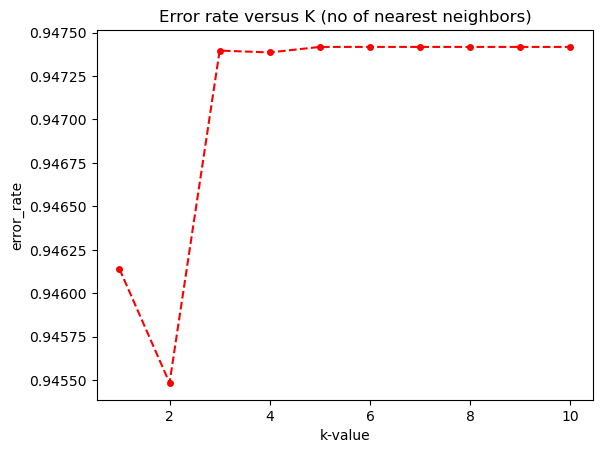

In [25]:
error_rate
plt.plot(range(1,11),error_rate,color="red",linestyle="dashed",marker='o',markersize=4)
plt.title("Error rate versus K (no of nearest neighbors)")
plt.xlabel("k-value")
plt.ylabel("error_rate")
plt.show()

In [26]:
knn = KNeighborsClassifier(n_neighbors=2)
knn.fit(x_sm,y_sm)
y_pred = knn.predict(x_test)
y_train_pred = knn.predict(x_train)
print('\033[1m'+'Training accuracy :'+'\033[0m' )
print(classification_report(y_train,y_train_pred))
print('\033[1m'+'Testing accuracy :'+'\033[0m' )
print(classification_report(y_test,y_pred))

Training accuracy :
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00    135022
         1.0       1.00      1.00      1.00     14978

    accuracy                           1.00    150000
   macro avg       1.00      1.00      1.00    150000
weighted avg       1.00      1.00      1.00    150000

Testing accuracy :
              precision    recall  f1-score   support

         0.0       0.94      0.00      0.01     44880
         1.0       0.10      1.00      0.19      5120

    accuracy                           0.11     50000
   macro avg       0.52      0.50      0.10     50000
weighted avg       0.85      0.11      0.03     50000



## Logistic Regression

In [26]:
lr = LogisticRegression()
lr.fit(x_sm,y_sm)
y_pred = lr.predict(x_test)
y_train_pred = lr.predict(x_train)
print('\033[1m'+'Training accuracy :'+'\033[0m' )
print(classification_report(y_train,y_train_pred))
print('\033[1m'+'Testing accuracy :'+'\033[0m' )
print(classification_report(y_test,y_pred))

Training accuracy :
              precision    recall  f1-score   support

         0.0       0.97      0.79      0.87    135022
         1.0       0.29      0.77      0.42     14978

    accuracy                           0.79    150000
   macro avg       0.63      0.78      0.65    150000
weighted avg       0.90      0.79      0.83    150000

Testing accuracy :
              precision    recall  f1-score   support

         0.0       0.97      0.79      0.87     44880
         1.0       0.29      0.76      0.42      5120

    accuracy                           0.79     50000
   macro avg       0.63      0.78      0.65     50000
weighted avg       0.90      0.79      0.82     50000



## SVC

In [25]:
svc = SVC(verbose=10)
svc.fit(x_sm,y_sm)
y_pred = svc.predict(x_test)
y_train_pred = svc.predict(x_train)
print('\033[1m'+'Training accuracy :'+'\033[0m' )
print(classification_report(y_train,y_train_pred))
print('\033[1m'+'Testing accuracy :'+'\033[0m' )
print(classification_report(y_test,y_pred))

[LibSVM]Training accuracy :
              precision    recall  f1-score   support

         0.0       0.99      0.99      0.99    135022
         1.0       0.92      0.95      0.94     14978

    accuracy                           0.99    150000
   macro avg       0.96      0.97      0.96    150000
weighted avg       0.99      0.99      0.99    150000

Testing accuracy :
              precision    recall  f1-score   support

         0.0       0.92      0.96      0.94     44880
         1.0       0.44      0.26      0.33      5120

    accuracy                           0.89     50000
   macro avg       0.68      0.61      0.63     50000
weighted avg       0.87      0.89      0.88     50000



## Decision Tree

In [22]:
dt = DecisionTreeClassifier()
dt.fit(x_sm,y_sm)
y_pred = dt.predict(x_test)
y_train_pred = dt.predict(x_train)
print('\033[1m'+'Training accuracy :'+'\033[0m' )
print(classification_report(y_train,y_train_pred))
print('\033[1m'+'Testing accuracy :'+'\033[0m' )
print(classification_report(y_test,y_pred))

Training accuracy :
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00    135022
         1.0       1.00      1.00      1.00     14978

    accuracy                           1.00    150000
   macro avg       1.00      1.00      1.00    150000
weighted avg       1.00      1.00      1.00    150000

Testing accuracy :
              precision    recall  f1-score   support

         0.0       0.91      0.75      0.82     44880
         1.0       0.13      0.32      0.18      5120

    accuracy                           0.70     50000
   macro avg       0.52      0.53      0.50     50000
weighted avg       0.83      0.70      0.75     50000



## Random forest

In [27]:
rf = RandomForestClassifier()
rf.fit(x_sm,y_sm)
y_pred = rf.predict(x_test)
y_train_pred = rf.predict(x_train)
print('\033[1m'+'Training Accuracy'+'\033[0m')
print(classification_report(y_train,y_train_pred))
print('\033[1m'+'Testing accuracy :'+'\033[0m' )
print(classification_report(y_test,y_pred))

Training Accuracy
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00    135022
         1.0       1.00      1.00      1.00     14978

    accuracy                           1.00    150000
   macro avg       1.00      1.00      1.00    150000
weighted avg       1.00      1.00      1.00    150000

Testing accuracy :
              precision    recall  f1-score   support

         0.0       0.90      0.99      0.94     44880
         1.0       0.31      0.02      0.04      5120

    accuracy                           0.89     50000
   macro avg       0.60      0.51      0.49     50000
weighted avg       0.84      0.89      0.85     50000



## Extra Trees Classifier

In [32]:
etc = ExtraTreesClassifier()
etc.fit(x_sm,y_sm)
y_pred = etc.predict(x_test)
y_train_pred = etc.predict(x_train)
print('\033[1m'+'Training Accuracy'+'\033[0m')
print(classification_report(y_train,y_train_pred))
print('\033[1m'+'Testing accuracy :'+'\033[0m' )
print(classification_report(y_test,y_pred))

Training Accuracy
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00    135022
         1.0       1.00      1.00      1.00     14978

    accuracy                           1.00    150000
   macro avg       1.00      1.00      1.00    150000
weighted avg       1.00      1.00      1.00    150000

Testing accuracy :
              precision    recall  f1-score   support

         0.0       0.90      1.00      0.95     44880
         1.0       0.36      0.01      0.02      5120

    accuracy                           0.90     50000
   macro avg       0.63      0.50      0.48     50000
weighted avg       0.84      0.90      0.85     50000



## Bagging Classifier

In [25]:
bgc = BaggingClassifier()
bgc.fit(x_sm,y_sm)
y_pred = bgc.predict(x_test)
y_train_pred = bgc.predict(x_train)
print('\033[1m'+'Training Accuracy'+'\033[0m')
print(classification_report(y_train,y_train_pred))
print('\033[1m'+'Testing accuracy :'+'\033[0m' )
print(classification_report(y_test,y_pred))

Training Accuracy
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00    135022
         1.0       1.00      0.99      0.99     14978

    accuracy                           1.00    150000
   macro avg       1.00      0.99      1.00    150000
weighted avg       1.00      1.00      1.00    150000

Testing accuracy :
              precision    recall  f1-score   support

         0.0       0.90      0.94      0.92     44880
         1.0       0.18      0.12      0.14      5120

    accuracy                           0.85     50000
   macro avg       0.54      0.53      0.53     50000
weighted avg       0.83      0.85      0.84     50000



## XGB

In [26]:
xgb = XGBClassifier()
xgb.fit(x_sm,y_sm)
y_pred = xgb.predict(x_test)
y_train_pred = xgb.predict(x_train)
print('\033[1m'+'Training Accuracy'+'\033[0m')
print(classification_report(y_train,y_train_pred))
print('\033[1m'+'Testing accuracy :'+'\033[0m' )
print(classification_report(y_test,y_pred))

Training Accuracy
              precision    recall  f1-score   support

         0.0       0.96      0.95      0.95    135022
         1.0       0.57      0.65      0.61     14978

    accuracy                           0.92    150000
   macro avg       0.77      0.80      0.78    150000
weighted avg       0.92      0.92      0.92    150000

Testing accuracy :
              precision    recall  f1-score   support

         0.0       0.92      0.91      0.92     44880
         1.0       0.29      0.32      0.30      5120

    accuracy                           0.85     50000
   macro avg       0.61      0.62      0.61     50000
weighted avg       0.86      0.85      0.85     50000



## Gradient Boosting

In [27]:
gb = GradientBoostingClassifier()
gb.fit(x_sm,y_sm)
y_pred = gb.predict(x_test)
y_train_pred = gb.predict(x_train)
print('\033[1m'+'Training Accuracy'+'\033[0m')
print(classification_report(y_train,y_train_pred))
print('\033[1m'+'Testing accuracy :'+'\033[0m' )
print(classification_report(y_test,y_pred))

Training Accuracy
              precision    recall  f1-score   support

         0.0       0.93      0.85      0.89    135022
         1.0       0.25      0.43      0.31     14978

    accuracy                           0.81    150000
   macro avg       0.59      0.64      0.60    150000
weighted avg       0.86      0.81      0.83    150000

Testing accuracy :
              precision    recall  f1-score   support

         0.0       0.92      0.85      0.88     44880
         1.0       0.21      0.37      0.27      5120

    accuracy                           0.80     50000
   macro avg       0.57      0.61      0.58     50000
weighted avg       0.85      0.80      0.82     50000



## ANN

In [26]:
from sklearn.neural_network import MLPClassifier
ann = MLPClassifier(hidden_layer_sizes=(50,3),learning_rate_init=0.1,max_iter=100,random_state=42)
ann.fit(x_sm,y_sm)
y_pred = ann.predict(x_test)
y_train_pred = ann.predict(x_train)
print('\033[1m'+'Training Accuracy'+'\033[0m')
print(classification_report(y_train,y_train_pred))
print('\033[1m'+'Testing accuracy :'+'\033[0m' )
print(classification_report(y_test,y_pred))

Training Accuracy
              precision    recall  f1-score   support

         0.0       0.97      0.88      0.92    135022
         1.0       0.41      0.75      0.53     14978

    accuracy                           0.87    150000
   macro avg       0.69      0.81      0.72    150000
weighted avg       0.91      0.87      0.88    150000

Testing accuracy :
              precision    recall  f1-score   support

         0.0       0.94      0.85      0.89     44880
         1.0       0.29      0.52      0.37      5120

    accuracy                           0.82     50000
   macro avg       0.61      0.69      0.63     50000
weighted avg       0.87      0.82      0.84     50000



# Model comparistion

In [27]:
from prettytable import PrettyTable
pt = PrettyTable()
pt.field_names = ['Model','Training Accuracy','Testing Acccuracy']
pt.add_row(['KNN','100%','11%'])
pt.add_row(['Logistic Regression','79%','79%'])
pt.add_row(['SVC','99%','89%'])
pt.add_row(['Decision Tree','100%','70%'])
pt.add_row(['Random Forest','100%','89%'])
pt.add_row(['Extra Trees Classifier','100%','90%'])
pt.add_row(['Bagging Classifier','100%','85%'])
pt.add_row(['XGB','92%','85%'])
pt.add_row(['Gradient Boosting','81%','80%'])
pt.add_row(['ANN','87%','82%'])
print(pt)

+------------------------+-------------------+-------------------+
|         Model          | Training Accuracy | Testing Acccuracy |
+------------------------+-------------------+-------------------+
|          KNN           |        100%       |        11%        |
|  Logistic Regression   |        79%        |        79%        |
|          SVC           |        99%        |        89%        |
|     Decision Tree      |        100%       |        70%        |
|     Random Forest      |        100%       |        89%        |
| Extra Trees Classifier |        100%       |        90%        |
|   Bagging Classifier   |        100%       |        85%        |
|          XGB           |        92%        |        85%        |
|   Gradient Boosting    |        81%        |        80%        |
|          ANN           |        87%        |        82%        |
+------------------------+-------------------+-------------------+


#### Insights
* From the above models, Extra trees classifier has the highest training accuuracy. So selecting it as the best model for hyper parameter tuning.

### Cross validation score

In [28]:
from sklearn.model_selection import cross_val_score
m = ExtraTreesClassifier()
score = cross_val_score(m,x,y,cv=5)
score.mean()

0.8995099999999999

## Hyper parameter tuning - Extra Trees Classifier

In [29]:
from sklearn.model_selection import GridSearchCV
etc = ExtraTreesClassifier()
params = {'n_estimators':[50,75],'max_features':['auto','sqrt','log2'],'min_samples_split':[2,5,10],
         'min_samples_leaf':[1,2,4],'max_depth':[None,5,10],'criterion':['gini','entropy']}
gcv_etc = GridSearchCV(estimator=etc,param_grid=params,cv=3,scoring='accuracy',verbose=10)
gcv_etc.fit(x_sm,y_sm)
gcv_etc.best_params_

Fitting 3 folds for each of 324 candidates, totalling 972 fits
[CV 1/3; 1/324] START criterion=gini, max_depth=None, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=50
[CV 1/3; 1/324] END criterion=gini, max_depth=None, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=50;, score=0.950 total time= 1.0min
[CV 2/3; 1/324] START criterion=gini, max_depth=None, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=50
[CV 2/3; 1/324] END criterion=gini, max_depth=None, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=50;, score=0.984 total time= 1.1min
[CV 3/3; 1/324] START criterion=gini, max_depth=None, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=50
[CV 3/3; 1/324] END criterion=gini, max_depth=None, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=50;, score=0.984 total time=  51.7s
[CV 1/3; 2/324] START criterion=gini, max_depth=None, max_featur

[CV 2/3; 10/324] END criterion=gini, max_depth=None, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=75;, score=0.989 total time= 1.4min
[CV 3/3; 10/324] START criterion=gini, max_depth=None, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=75
[CV 3/3; 10/324] END criterion=gini, max_depth=None, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=75;, score=0.989 total time= 1.2min
[CV 1/3; 11/324] START criterion=gini, max_depth=None, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=50
[CV 1/3; 11/324] END criterion=gini, max_depth=None, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=50;, score=0.932 total time=  51.9s
[CV 2/3; 11/324] START criterion=gini, max_depth=None, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=50
[CV 2/3; 11/324] END criterion=gini, max_depth=None, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_es

[CV 3/3; 19/324] END criterion=gini, max_depth=None, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=50;, score=0.983 total time=  49.9s
[CV 1/3; 20/324] START criterion=gini, max_depth=None, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=75
[CV 1/3; 20/324] END criterion=gini, max_depth=None, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=75;, score=0.956 total time= 1.4min
[CV 2/3; 20/324] START criterion=gini, max_depth=None, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=75
[CV 2/3; 20/324] END criterion=gini, max_depth=None, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=75;, score=0.990 total time= 1.3min
[CV 3/3; 20/324] START criterion=gini, max_depth=None, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=75
[CV 3/3; 20/324] END criterion=gini, max_depth=None, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estima

[CV 1/3; 29/324] END criterion=gini, max_depth=None, max_features=sqrt, min_samples_leaf=2, min_samples_split=10, n_estimators=50;, score=0.933 total time=  53.0s
[CV 2/3; 29/324] START criterion=gini, max_depth=None, max_features=sqrt, min_samples_leaf=2, min_samples_split=10, n_estimators=50
[CV 2/3; 29/324] END criterion=gini, max_depth=None, max_features=sqrt, min_samples_leaf=2, min_samples_split=10, n_estimators=50;, score=0.983 total time=  47.8s
[CV 3/3; 29/324] START criterion=gini, max_depth=None, max_features=sqrt, min_samples_leaf=2, min_samples_split=10, n_estimators=50
[CV 3/3; 29/324] END criterion=gini, max_depth=None, max_features=sqrt, min_samples_leaf=2, min_samples_split=10, n_estimators=50;, score=0.982 total time=  47.0s
[CV 1/3; 30/324] START criterion=gini, max_depth=None, max_features=sqrt, min_samples_leaf=2, min_samples_split=10, n_estimators=75
[CV 1/3; 30/324] END criterion=gini, max_depth=None, max_features=sqrt, min_samples_leaf=2, min_samples_split=10, n

[CV 2/3; 38/324] END criterion=gini, max_depth=None, max_features=log2, min_samples_leaf=1, min_samples_split=2, n_estimators=75;, score=0.989 total time=  46.5s
[CV 3/3; 38/324] START criterion=gini, max_depth=None, max_features=log2, min_samples_leaf=1, min_samples_split=2, n_estimators=75
[CV 3/3; 38/324] END criterion=gini, max_depth=None, max_features=log2, min_samples_leaf=1, min_samples_split=2, n_estimators=75;, score=0.989 total time=  46.9s
[CV 1/3; 39/324] START criterion=gini, max_depth=None, max_features=log2, min_samples_leaf=1, min_samples_split=5, n_estimators=50
[CV 1/3; 39/324] END criterion=gini, max_depth=None, max_features=log2, min_samples_leaf=1, min_samples_split=5, n_estimators=50;, score=0.943 total time=  32.1s
[CV 2/3; 39/324] START criterion=gini, max_depth=None, max_features=log2, min_samples_leaf=1, min_samples_split=5, n_estimators=50
[CV 2/3; 39/324] END criterion=gini, max_depth=None, max_features=log2, min_samples_leaf=1, min_samples_split=5, n_estima

[CV 3/3; 47/324] END criterion=gini, max_depth=None, max_features=log2, min_samples_leaf=2, min_samples_split=10, n_estimators=50;, score=0.981 total time=  28.4s
[CV 1/3; 48/324] START criterion=gini, max_depth=None, max_features=log2, min_samples_leaf=2, min_samples_split=10, n_estimators=75
[CV 1/3; 48/324] END criterion=gini, max_depth=None, max_features=log2, min_samples_leaf=2, min_samples_split=10, n_estimators=75;, score=0.932 total time=  46.8s
[CV 2/3; 48/324] START criterion=gini, max_depth=None, max_features=log2, min_samples_leaf=2, min_samples_split=10, n_estimators=75
[CV 2/3; 48/324] END criterion=gini, max_depth=None, max_features=log2, min_samples_leaf=2, min_samples_split=10, n_estimators=75;, score=0.987 total time=  44.0s
[CV 3/3; 48/324] START criterion=gini, max_depth=None, max_features=log2, min_samples_leaf=2, min_samples_split=10, n_estimators=75
[CV 3/3; 48/324] END criterion=gini, max_depth=None, max_features=log2, min_samples_leaf=2, min_samples_split=10, n

[CV 2/3; 57/324] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=50;, score=0.835 total time=  15.5s
[CV 3/3; 57/324] START criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=50
[CV 3/3; 57/324] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=50;, score=0.827 total time=  15.2s
[CV 1/3; 58/324] START criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=75
[CV 1/3; 58/324] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=75;, score=0.775 total time=  22.9s
[CV 2/3; 58/324] START criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=75
[CV 2/3; 58/324] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=75;, score=0.843

[CV 1/3; 67/324] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=50;, score=0.759 total time=  15.1s
[CV 2/3; 67/324] START criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=50
[CV 2/3; 67/324] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=50;, score=0.830 total time=  15.2s
[CV 3/3; 67/324] START criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=50
[CV 3/3; 67/324] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=50;, score=0.828 total time=  15.8s
[CV 1/3; 68/324] START criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=75
[CV 1/3; 68/324] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=75;, score=0.777

[CV 3/3; 76/324] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=75;, score=0.843 total time=  23.1s
[CV 1/3; 77/324] START criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=50
[CV 1/3; 77/324] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=50;, score=0.763 total time=  15.1s
[CV 2/3; 77/324] START criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=50
[CV 2/3; 77/324] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=50;, score=0.832 total time=  15.2s
[CV 3/3; 77/324] START criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=50
[CV 3/3; 77/324] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=50;, score

[CV 2/3; 86/324] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, n_estimators=75;, score=0.845 total time=  23.4s
[CV 3/3; 86/324] START criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, n_estimators=75
[CV 3/3; 86/324] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, n_estimators=75;, score=0.840 total time=  23.6s
[CV 1/3; 87/324] START criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, n_estimators=50
[CV 1/3; 87/324] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, n_estimators=50;, score=0.762 total time=  15.5s
[CV 2/3; 87/324] START criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, n_estimators=50
[CV 2/3; 87/324] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, n_estimators=50;, score=0.832

[CV 1/3; 96/324] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=1, min_samples_split=10, n_estimators=75;, score=0.775 total time=  13.3s
[CV 2/3; 96/324] START criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=1, min_samples_split=10, n_estimators=75
[CV 2/3; 96/324] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=1, min_samples_split=10, n_estimators=75;, score=0.853 total time=  14.2s
[CV 3/3; 96/324] START criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=1, min_samples_split=10, n_estimators=75
[CV 3/3; 96/324] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=1, min_samples_split=10, n_estimators=75;, score=0.858 total time=  14.1s
[CV 1/3; 97/324] START criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=2, min_samples_split=2, n_estimators=50
[CV 1/3; 97/324] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=2, min_samples_split=2, n_estimators=50;, score=

[CV 3/3; 105/324] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=5, n_estimators=50;, score=0.841 total time=   8.8s
[CV 1/3; 106/324] START criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=5, n_estimators=75
[CV 1/3; 106/324] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=5, n_estimators=75;, score=0.776 total time=  12.9s
[CV 2/3; 106/324] START criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=5, n_estimators=75
[CV 2/3; 106/324] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=5, n_estimators=75;, score=0.855 total time=  13.0s
[CV 3/3; 106/324] START criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=5, n_estimators=75
[CV 3/3; 106/324] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=5, n_estimators=75;, scor

[CV 2/3; 115/324] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=50;, score=0.890 total time=  30.6s
[CV 3/3; 115/324] START criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=50
[CV 3/3; 115/324] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=50;, score=0.888 total time=  36.7s
[CV 1/3; 116/324] START criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=75
[CV 1/3; 116/324] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=75;, score=0.822 total time=  43.8s
[CV 2/3; 116/324] START criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=75
[CV 2/3; 116/324] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=75

[CV 1/3; 125/324] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=50;, score=0.814 total time=  28.2s
[CV 2/3; 125/324] START criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=50
[CV 2/3; 125/324] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=50;, score=0.886 total time=  28.0s
[CV 3/3; 125/324] START criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=50
[CV 3/3; 125/324] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=50;, score=0.888 total time=  27.7s
[CV 1/3; 126/324] START criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=75
[CV 1/3; 126/324] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estima

[CV 3/3; 134/324] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, n_estimators=75;, score=0.898 total time=  42.4s
[CV 1/3; 135/324] START criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=50
[CV 1/3; 135/324] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=50;, score=0.815 total time=  28.1s
[CV 2/3; 135/324] START criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=50
[CV 2/3; 135/324] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=50;, score=0.887 total time=  27.5s
[CV 3/3; 135/324] START criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=50
[CV 3/3; 135/324] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=50

[CV 2/3; 144/324] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_split=10, n_estimators=75;, score=0.896 total time=  47.6s
[CV 3/3; 144/324] START criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_split=10, n_estimators=75
[CV 3/3; 144/324] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_split=10, n_estimators=75;, score=0.895 total time= 1.4min
[CV 1/3; 145/324] START criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=1, min_samples_split=2, n_estimators=50
[CV 1/3; 145/324] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=1, min_samples_split=2, n_estimators=50;, score=0.812 total time=  24.2s
[CV 2/3; 145/324] START criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=1, min_samples_split=2, n_estimators=50
[CV 2/3; 145/324] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=1, min_samples_split=2, n_estimators

[CV 1/3; 154/324] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=5, n_estimators=75;, score=0.821 total time=  23.4s
[CV 2/3; 154/324] START criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=5, n_estimators=75
[CV 2/3; 154/324] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=5, n_estimators=75;, score=0.903 total time=  23.5s
[CV 3/3; 154/324] START criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=5, n_estimators=75
[CV 3/3; 154/324] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=5, n_estimators=75;, score=0.899 total time=  24.5s
[CV 1/3; 155/324] START criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=10, n_estimators=50
[CV 1/3; 155/324] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=10, n_estimators=

[CV 3/3; 163/324] END criterion=entropy, max_depth=None, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=50;, score=0.984 total time=  50.3s
[CV 1/3; 164/324] START criterion=entropy, max_depth=None, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=75
[CV 1/3; 164/324] END criterion=entropy, max_depth=None, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=75;, score=0.955 total time= 1.4min
[CV 2/3; 164/324] START criterion=entropy, max_depth=None, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=75
[CV 2/3; 164/324] END criterion=entropy, max_depth=None, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=75;, score=0.990 total time= 1.3min
[CV 3/3; 164/324] START criterion=entropy, max_depth=None, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=75
[CV 3/3; 164/324] END criterion=entropy, max_depth=None, max_features=auto, min_samples_leaf=1, m

[CV 1/3; 173/324] END criterion=entropy, max_depth=None, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=50;, score=0.936 total time=  52.0s
[CV 2/3; 173/324] START criterion=entropy, max_depth=None, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=50
[CV 2/3; 173/324] END criterion=entropy, max_depth=None, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=50;, score=0.983 total time=  48.7s
[CV 3/3; 173/324] START criterion=entropy, max_depth=None, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=50
[CV 3/3; 173/324] END criterion=entropy, max_depth=None, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=50;, score=0.983 total time=  49.1s
[CV 1/3; 174/324] START criterion=entropy, max_depth=None, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=75
[CV 1/3; 174/324] END criterion=entropy, max_depth=None, max_features=auto, min_samples_lea

[CV 2/3; 182/324] END criterion=entropy, max_depth=None, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=75;, score=0.990 total time= 1.3min
[CV 3/3; 182/324] START criterion=entropy, max_depth=None, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=75
[CV 3/3; 182/324] END criterion=entropy, max_depth=None, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=75;, score=0.989 total time= 1.3min
[CV 1/3; 183/324] START criterion=entropy, max_depth=None, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=50
[CV 1/3; 183/324] END criterion=entropy, max_depth=None, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=50;, score=0.947 total time=  53.5s
[CV 2/3; 183/324] START criterion=entropy, max_depth=None, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=50
[CV 2/3; 183/324] END criterion=entropy, max_depth=None, max_features=sqrt, min_samples_leaf=1, m

[CV 3/3; 191/324] END criterion=entropy, max_depth=None, max_features=sqrt, min_samples_leaf=2, min_samples_split=10, n_estimators=50;, score=0.984 total time=  48.5s
[CV 1/3; 192/324] START criterion=entropy, max_depth=None, max_features=sqrt, min_samples_leaf=2, min_samples_split=10, n_estimators=75
[CV 1/3; 192/324] END criterion=entropy, max_depth=None, max_features=sqrt, min_samples_leaf=2, min_samples_split=10, n_estimators=75;, score=0.939 total time= 1.3min
[CV 2/3; 192/324] START criterion=entropy, max_depth=None, max_features=sqrt, min_samples_leaf=2, min_samples_split=10, n_estimators=75
[CV 2/3; 192/324] END criterion=entropy, max_depth=None, max_features=sqrt, min_samples_leaf=2, min_samples_split=10, n_estimators=75;, score=0.988 total time= 1.2min
[CV 3/3; 192/324] START criterion=entropy, max_depth=None, max_features=sqrt, min_samples_leaf=2, min_samples_split=10, n_estimators=75
[CV 3/3; 192/324] END criterion=entropy, max_depth=None, max_features=sqrt, min_samples_lea

[CV 1/3; 201/324] END criterion=entropy, max_depth=None, max_features=log2, min_samples_leaf=1, min_samples_split=5, n_estimators=50;, score=0.944 total time=  33.6s
[CV 2/3; 201/324] START criterion=entropy, max_depth=None, max_features=log2, min_samples_leaf=1, min_samples_split=5, n_estimators=50
[CV 2/3; 201/324] END criterion=entropy, max_depth=None, max_features=log2, min_samples_leaf=1, min_samples_split=5, n_estimators=50;, score=0.984 total time=  31.2s
[CV 3/3; 201/324] START criterion=entropy, max_depth=None, max_features=log2, min_samples_leaf=1, min_samples_split=5, n_estimators=50
[CV 3/3; 201/324] END criterion=entropy, max_depth=None, max_features=log2, min_samples_leaf=1, min_samples_split=5, n_estimators=50;, score=0.984 total time=  31.4s
[CV 1/3; 202/324] START criterion=entropy, max_depth=None, max_features=log2, min_samples_leaf=1, min_samples_split=5, n_estimators=75
[CV 1/3; 202/324] END criterion=entropy, max_depth=None, max_features=log2, min_samples_leaf=1, m

[CV 2/3; 210/324] END criterion=entropy, max_depth=None, max_features=log2, min_samples_leaf=2, min_samples_split=10, n_estimators=75;, score=0.988 total time=  44.7s
[CV 3/3; 210/324] START criterion=entropy, max_depth=None, max_features=log2, min_samples_leaf=2, min_samples_split=10, n_estimators=75
[CV 3/3; 210/324] END criterion=entropy, max_depth=None, max_features=log2, min_samples_leaf=2, min_samples_split=10, n_estimators=75;, score=0.988 total time=  44.7s
[CV 1/3; 211/324] START criterion=entropy, max_depth=None, max_features=log2, min_samples_leaf=4, min_samples_split=2, n_estimators=50
[CV 1/3; 211/324] END criterion=entropy, max_depth=None, max_features=log2, min_samples_leaf=4, min_samples_split=2, n_estimators=50;, score=0.923 total time=  32.0s
[CV 2/3; 211/324] START criterion=entropy, max_depth=None, max_features=log2, min_samples_leaf=4, min_samples_split=2, n_estimators=50
[CV 2/3; 211/324] END criterion=entropy, max_depth=None, max_features=log2, min_samples_leaf=4

[CV 3/3; 219/324] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=50;, score=0.833 total time=  15.5s
[CV 1/3; 220/324] START criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=75
[CV 1/3; 220/324] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=75;, score=0.774 total time=  23.0s
[CV 2/3; 220/324] START criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=75
[CV 2/3; 220/324] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=75;, score=0.846 total time=  22.8s
[CV 3/3; 220/324] START criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=75
[CV 3/3; 220/324] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=5, n

[CV 1/3; 229/324] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=50;, score=0.760 total time=  15.0s
[CV 2/3; 229/324] START criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=50
[CV 2/3; 229/324] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=50;, score=0.829 total time=  15.3s
[CV 3/3; 229/324] START criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=50
[CV 3/3; 229/324] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=50;, score=0.832 total time=  15.2s
[CV 1/3; 230/324] START criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=75
[CV 1/3; 230/324] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, n

[CV 2/3; 238/324] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=75;, score=0.849 total time=  23.6s
[CV 3/3; 238/324] START criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=75
[CV 3/3; 238/324] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=75;, score=0.843 total time=  23.4s
[CV 1/3; 239/324] START criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=50
[CV 1/3; 239/324] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=50;, score=0.761 total time=  15.3s
[CV 2/3; 239/324] START criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=50
[CV 2/3; 239/324] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=1

[CV 3/3; 247/324] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, n_estimators=50;, score=0.834 total time=  15.3s
[CV 1/3; 248/324] START criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, n_estimators=75
[CV 1/3; 248/324] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, n_estimators=75;, score=0.772 total time=  22.9s
[CV 2/3; 248/324] START criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, n_estimators=75
[CV 2/3; 248/324] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, n_estimators=75;, score=0.844 total time=  23.4s
[CV 3/3; 248/324] START criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, n_estimators=75
[CV 3/3; 248/324] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, n

[CV 1/3; 257/324] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=1, min_samples_split=10, n_estimators=50;, score=0.763 total time=   8.7s
[CV 2/3; 257/324] START criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=1, min_samples_split=10, n_estimators=50
[CV 2/3; 257/324] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=1, min_samples_split=10, n_estimators=50;, score=0.842 total time=   8.3s
[CV 3/3; 257/324] START criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=1, min_samples_split=10, n_estimators=50
[CV 3/3; 257/324] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=1, min_samples_split=10, n_estimators=50;, score=0.836 total time=   8.3s
[CV 1/3; 258/324] START criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=1, min_samples_split=10, n_estimators=75
[CV 1/3; 258/324] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=1, min_samples_spli

[CV 2/3; 266/324] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=2, n_estimators=75;, score=0.855 total time=  15.2s
[CV 3/3; 266/324] START criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=2, n_estimators=75
[CV 3/3; 266/324] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=2, n_estimators=75;, score=0.850 total time=  15.2s
[CV 1/3; 267/324] START criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=5, n_estimators=50
[CV 1/3; 267/324] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=5, n_estimators=50;, score=0.762 total time=  10.2s
[CV 2/3; 267/324] START criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=5, n_estimators=50
[CV 2/3; 267/324] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=5, n

[CV 3/3; 275/324] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=50;, score=0.886 total time=  27.5s
[CV 1/3; 276/324] START criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=75
[CV 1/3; 276/324] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=75;, score=0.817 total time=  41.8s
[CV 2/3; 276/324] START criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=75
[CV 2/3; 276/324] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=75;, score=0.895 total time=  40.9s
[CV 3/3; 276/324] START criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=75
[CV 3/3; 276/324] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_sampl

[CV 1/3; 285/324] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=50;, score=0.809 total time=  28.5s
[CV 2/3; 285/324] START criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=50
[CV 2/3; 285/324] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=50;, score=0.887 total time=  27.1s
[CV 3/3; 285/324] START criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=50
[CV 3/3; 285/324] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=50;, score=0.886 total time=  28.0s
[CV 1/3; 286/324] START criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=75
[CV 1/3; 286/324] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_spl

[CV 2/3; 294/324] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=75;, score=0.898 total time=  40.8s
[CV 3/3; 294/324] START criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=75
[CV 3/3; 294/324] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=75;, score=0.895 total time=  41.4s
[CV 1/3; 295/324] START criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, n_estimators=50
[CV 1/3; 295/324] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, n_estimators=50;, score=0.809 total time=  27.8s
[CV 2/3; 295/324] START criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, n_estimators=50
[CV 2/3; 295/324] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_

[CV 3/3; 303/324] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, n_estimators=50;, score=0.884 total time=  27.6s
[CV 1/3; 304/324] START criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, n_estimators=75
[CV 1/3; 304/324] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, n_estimators=75;, score=0.815 total time=  42.6s
[CV 2/3; 304/324] START criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, n_estimators=75
[CV 2/3; 304/324] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, n_estimators=75;, score=0.894 total time=  40.9s
[CV 3/3; 304/324] START criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, n_estimators=75
[CV 3/3; 304/324] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_spl

[CV 1/3; 313/324] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=2, n_estimators=50;, score=0.805 total time=  15.8s
[CV 2/3; 313/324] START criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=2, n_estimators=50
[CV 2/3; 313/324] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=2, n_estimators=50;, score=0.889 total time=  15.1s
[CV 3/3; 313/324] START criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=2, n_estimators=50
[CV 3/3; 313/324] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=2, n_estimators=50;, score=0.890 total time=  15.3s
[CV 1/3; 314/324] START criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=2, n_estimators=75
[CV 1/3; 314/324] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_spl

[CV 2/3; 322/324] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=4, min_samples_split=5, n_estimators=75;, score=0.899 total time=  22.9s
[CV 3/3; 322/324] START criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=4, min_samples_split=5, n_estimators=75
[CV 3/3; 322/324] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=4, min_samples_split=5, n_estimators=75;, score=0.900 total time=  22.9s
[CV 1/3; 323/324] START criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=4, min_samples_split=10, n_estimators=50
[CV 1/3; 323/324] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=4, min_samples_split=10, n_estimators=50;, score=0.802 total time=  15.5s
[CV 2/3; 323/324] START criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=4, min_samples_split=10, n_estimators=50
[CV 2/3; 323/324] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=4, min_samples_

{'criterion': 'gini',
 'max_depth': None,
 'max_features': 'sqrt',
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 75}

In [31]:
etc = ExtraTreesClassifier(criterion='gini',max_depth=None,max_features='sqrt',min_samples_leaf=1,min_samples_split=2,n_estimators=75)
etc.fit(x_sm,y_sm)
y_pred = etc.predict(x_test)
print(classification_report(y_pred,y_test))

              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95     49765
         1.0       0.02      0.34      0.03       235

    accuracy                           0.90     50000
   macro avg       0.51      0.62      0.49     50000
weighted avg       0.99      0.90      0.94     50000



## Conclusion

In the Customer Transaction Prediction project, our goal was to develop an accurate predictive model for classifying customer transactions as successful or unsuccessful. Despite challenges such as limited feature information and the absence of Exploratory Data Analysis (EDA), we successfully processed a substantial dataset containing 2 lakh rows and 200 features.

Addressing the normal distribution of data, we applied the 3-sigma method to mitigate outliers, but this intervention didn't yield improvements in accuracy. We embarked on an investigation into the effects of Principal Component Analysis (PCA) and found that omitting PCA led to a 1% accuracy enhancement in the models, indicating that the additional dimensionality reduction wasn't beneficial for our particular data. So we created models without PCA.

Among the models tested, the Extra Trees Classifier emerged as the most promising candidate. It demonstrated remarkable performance with 100% training accuracy, 90% testing accuracy, and an 89% cross-validation score. Despite rigorous hyperparameter tuning, the model's accuracy remained consistent, suggesting that we reached its optimal configuration.

In summary, while the absence of feature details hindered comprehensive data exploration, our project showcased the significance of model selection and adaptation in achieving accurate predictions. The Extra Trees Classifier's robust performance underscores its potential for real-world applications requiring transaction predictions. Looking ahead, further exploration of advanced algorithms and techniques could provide avenues for fine-tuning and enhancing prediction accuracy even more.

So based on the observations above, we can conclude that **Extra Trees Classifier** is the best-fitting model. With the **testing data**, we achieved an accuracy of **90%**, and with **training data**, we achieved an accuracy of **100%**. With hyper parameter tuning, we achieved 9% increase in weighted avg.

## Challenges faced

1. **Limited Feature Details:** The absence of comprehensive information about the 200 features hindered a deeper understanding of the data, making it challenging to make informed decisions about feature selection, engineering, and model building.


2. **No Exploratory Data Analysis (EDA):** Without the ability to perform EDA due to the lack of feature details, you were unable to identify potential patterns, correlations, or anomalies in the data that could have influenced your modeling choices.


3. **Data Volume:** Managing a dataset with over 2 lakh rows and 200 features introduced computational and memory challenges during preprocessing, modeling, and evaluation stages.


4. **Dimensionality Reduction:** Determining whether to apply Principal Component Analysis (PCA) or not introduced a challenge. Deciding on the optimal number of components and evaluating the trade-off between dimensionality reduction and potential loss of information was complex.


5. **Model Selection:** Choosing the right machine learning algorithms that could perform well with limited feature information was a challenge. Additionally, comparing the performance of different algorithms and identifying the most suitable one required thorough experimentation.


6. **Large Computational Time:** The sheer size of the dataset, with over 2 lakh rows and 200 features, led to significant computational challenges during the model creation phase. Training and evaluating models on such voluminous data demanded substantial processing power and memory, often resulting in extended computational times. The hyper parameter tuning of Extra Trees Classifier took almost 12 hours.


7. **Hyperparameter Tuning:** Although hyperparameter tuning was attempted, not achieving an accuracy increase after exhaustive tuning could be attributed to reaching the model's performance limit given the constraints of the dataset.
